In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.nn.functional as F
import torch.optim as optim

/home/manu/venv/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
from torchvision import datasets, models, transforms
from utils import view_data
from typing import List, Tuple

In [4]:
from easydict import EasyDict as edict
import pickle

In [5]:
args = edict({})
args.image_size = 240
args.batch_size = 25
args.log_interval = 100

In [6]:
# normalization used to train VGG
# see https://pytorch.org/hub/pytorch_vision_vgg/
v_mean = np.array([0.485, 0.456, 0.406])
v_std = np.array([0.229, 0.224, 0.225])
transforms_norm = transforms.Normalize(mean=v_mean, std=v_std) # to normalize colors on the imagenet dataset



In [7]:
transform_base =  transforms.Compose([
            transforms.Resize((int(args.image_size), int(args.image_size))),
            transforms.ToTensor(),  # Convert the image to pyTorch Tensor data type.
            transforms_norm, ])      
    

In [8]:
#path = '/run/user/1001/gvfs/dav:host=spik.xyz,ssl=true,prefix=%2Fnc%2Fremote.php%2Fdav/files/emmanuel/JNJER_PhD/'
#path = "/envau/work/brainets/dauce.e/data/animal/"
path = "/media/manu/Seagate Expansion Drive/"
#path = "/run/user/1001/gvfs/sftp:host=bag-008-de03/envau/work/brainets/dauce.e/data/animal/"
#path = "../data/animal/"
image_path = "Data/animal/"

image_dataset = { 'train' : datasets.ImageFolder(
                            path+image_path+'train',
                            transform=transform_base
                        ),
                  'test' : datasets.ImageFolder(
                            path+image_path+'test',
                          transform=transform_base
                        )
                }

In [9]:
num_workers = 1

dataloader = { 'train' : torch.utils.data.DataLoader(
                            image_dataset['train'], batch_size=args.batch_size,
                            shuffle=True, 
                            num_workers=num_workers,
                        ),
               'test' : torch.utils.data.DataLoader(
                            image_dataset['test'], batch_size=args.batch_size,
                            shuffle=True, 
                            num_workers=num_workers,
                        )
             }

In [10]:
data, label = next(iter(dataloader['train']))

In [11]:
data.shape

torch.Size([25, 3, 240, 240])

In [12]:
def img_denorm(img, mean, std):
    #for ImageNet the mean and std are:
    #mean = np.asarray([ 0.485, 0.456, 0.406 ])
    #std = np.asarray([ 0.229, 0.224, 0.225 ])

    denormalize = transforms.Normalize((-1 * mean / std), (1.0 / std))

    res = img.squeeze(0)
    res = denormalize(res)

    #Image needs to be clipped since the denormalize function will map some
    #values below 0 and above 1
    res = torch.clamp(res, 0, 1)
    
    return(res)

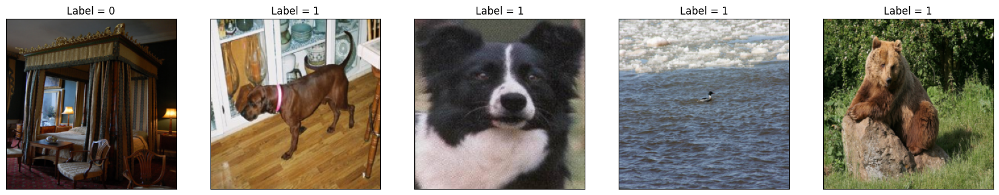

In [13]:
from utils import view_data
for i in range(len(data)):
    data[i] = img_denorm(data[i], v_mean, v_std)
original = view_data(data, label, 5)

In [14]:
len(data)

25

In [15]:
def expand_dim(tensor, dim, desired_dim_len):
    sz = list(tensor.size())
    sz[dim]=desired_dim_len
    return tensor.expand(tuple(sz))

In [16]:
def kl_divergence(model, z):
    # --------------------------
    # Monte carlo KL divergence
    # --------------------------
    # 1. define the first two probabilities (in this case Normal for both)
    p = torch.distributions.Normal(torch.zeros_like(z), args.std_sched  * torch.ones_like(z))

    # 2. get the probabilities from the equation
    log_qzx = model.q.log_prob(z)
    log_pz = p.log_prob(z)

    # kl
    kl = (log_qzx - log_pz)
    
    # sum over last dim to go from single dim distribution to multi-dim
    kl = model.LAMBDA * kl.sum()
    return kl

In [17]:
class Grid_AttentionTransNet(nn.Module):
    
    def __init__(self, do_stn=True, LAMBDA=.1, deterministic=False):
        super(Grid_AttentionTransNet, self).__init__()
        
        self.do_stn = do_stn
        self.deterministic = deterministic
        self.LAMBDA = LAMBDA
        
        self.vgg = models.vgg16(pretrained=True) 
        self.vgg_where = models.vgg16(pretrained=True) 
        
        ##  The what pathway
        
        self.num_features = self.vgg.classifier[-1].in_features
        features = list(self.vgg.classifier.children())[:-1] # Remove last layer
        #features.extend([nn.Linear(num_features, 500)]) # Add our layer
        self.vgg.classifier = nn.Sequential(*features) # Replace the model classifier
        
        self.what_grid = self.logPolarGrid(-1,-4) 
        
        n_features = torch.tensor(self.num_features, dtype=torch.float)
        
        self.fc_what = nn.Linear(self.num_features, 2)
        self.fc_what.weight.data /= torch.sqrt(n_features)
        self.fc_what.bias.data /= torch.sqrt(n_features)

        ##  The where pathway        
        self.num_features = self.vgg_where.classifier[-1].in_features
        features = list(self.vgg_where.classifier.children())[:-1] # Remove last layer
        #features.extend([nn.Linear(num_features, 500)]) # Add our layer
        self.vgg_where.classifier = nn.Sequential(*features) # Replace the model classifier
        
        self.where_grid = self.logPolarGrid(0,-3)
        
        self.mu = nn.Linear(self.num_features, 2) #, bias=False)
        self.logvar = nn.Linear(self.num_features, 2) #, bias=False)
        
        self.mu.weight.data /= torch.sqrt(n_features) 
        self.mu.bias.data /= torch.sqrt(n_features)
        
        self.logvar.weight.data /= torch.sqrt(n_features)
        self.logvar.bias.data /= torch.sqrt(n_features)

        self.downscale = nn.Parameter(torch.tensor([[1, 0], [0, 1]],
                                                   dtype=torch.float),
                                      requires_grad=False)
        self.dropout = torch.nn.Dropout()
    
    def logPolarGrid(self, a, b, base=2):
        rs = torch.logspace(a, b, args.image_size, base = base)
        ts = torch.linspace(0, torch.pi*2, args.image_size)
        
        grid_xs = torch.outer(rs, torch.cos(ts)) 
        grid_xs = grid_xs.unsqueeze(0).unsqueeze(3)
        grid_xs = Variable(grid_xs, requires_grad=False)

        grid_ys = torch.outer(rs, torch.sin(ts)) 
        grid_ys = grid_ys.unsqueeze(0).unsqueeze(3)
        grid_ys = Variable(grid_ys,  requires_grad=False)
        
        grid = torch.cat((grid_xs, grid_ys), 3)
        grid = expand_dim(grid, 0, args.batch_size)
        
        return grid.to(device)    

    def stn(self: object, x: torch.Tensor) -> Tuple[torch.Tensor]:
    
        logPolx = x #F.grid_sample(x, self.where_grid)
        
        if self.do_stn:
            if True: #
                with torch.no_grad():
                    y = self.vgg_where(logPolx)
                mu = self.mu(y)
                                   
                if self.deterministic:
                    self.q = torch.distributions.Normal(mu, .1 * torch.ones_like(mu))  
                    z = mu
                else:
                    logvar = self.logvar(y) + 1
                    sigma = torch.exp(-logvar / 2)
                    self.q = torch.distributions.Normal(mu, sigma)      
                    z = self.q.rsample()
            print(z[0,...])
            theta = torch.cat((self.downscale.unsqueeze(0).repeat(
                                z.size(0), 1, 1), z.unsqueeze(2)),
                                  dim=2)
        
            grid_size = torch.Size([x.size()[0], x.size()[1], args.image_size, args.image_size])
            grid = F.affine_grid(theta, grid_size)
            x = F.grid_sample(x, grid)

        else:
            theta = nn.Parameter(torch.tensor([[1, 0, 0], [0, 1, 0]],
                                                   dtype=torch.float),
                                      requires_grad=False)
            theta = theta.unsqueeze(0).repeat(x.size()[0], 1, 1)
            z = torch.tensor([0, 0],dtype=torch.float)
            z = z.unsqueeze(0).repeat(x.size()[0], 1)
           
        return x, theta, z

    def forward(self, x):
        # transform the input
        x, theta, z = self.stn(x)
        
        logPolx = F.grid_sample(x, self.what_grid)
        if True: #with torch.no_grad():
            y = self.vgg(logPolx)  
        y = self.fc_what(y)
       
        return y, theta, z

In [18]:
lr = 1e-4
LAMBDA = 1e-6
do_stn=True
deterministic=True

In [19]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model = torch.load("../models/low_comp_polo_stn.pt")
model = Grid_AttentionTransNet(do_stn=do_stn, deterministic=deterministic).to(device)

/home/manu/venv/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/manu/venv/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [36]:
path = 'out/'
#f_prefix = "230107b_logPolarGrid_vgg_stn_True_0.01_0.1"
#f_prefix = '230105b2_logPolarGrid_vgg_stn_True_0.1_0.1'
#f_prefix = "230221_logPolarGrid_vgg_stn_0.001_0.3"
#f_prefix = "230221_logPolarGrid_vgg_stn_0_1"
f_prefix = "230221b_logPolarGrid_vgg_stn_0_1"
f_prefix = "230221d_logPolarGrid_vgg_stn_0_1"



In [37]:
with open(f"{path}{f_prefix}.pkl", "rb") as f:
    data = pickle.load(f)
data=edict(data)

Text(0.5, 1.0, 'Entropy')

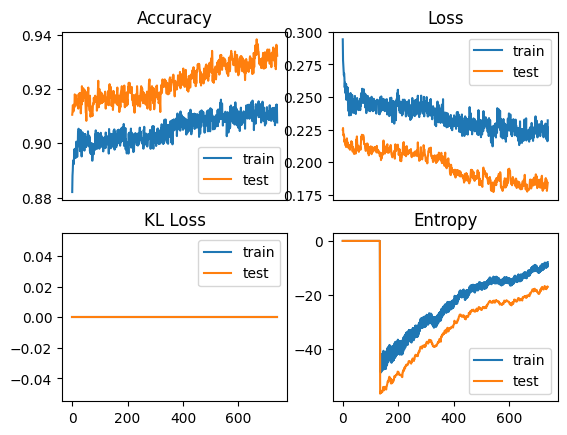

In [ ]:
plt.subplot(2,2,1)
plt.plot(data.train_acc, label='train')
plt.plot(data.test_acc, label='test')
plt.legend()
plt.xticks([])
plt.title('Accuracy')
plt.subplot(2,2,2)
plt.plot(data.train_loss, label='train')
plt.plot(data.test_loss, label='test')
plt.legend()
plt.title('Loss')
plt.xticks([])
plt.subplot(2,2,3)
plt.plot(data.train_kl_loss, label='train')
plt.plot(data.test_kl_loss, label='test')
plt.legend()
plt.title('KL Loss')
plt.subplot(2,2,4)
plt.plot(data.train_entropy, label='train')
plt.plot(data.test_entropy, label='test')
plt.legend()
plt.title('Entropy')

(0.9, 0.95)

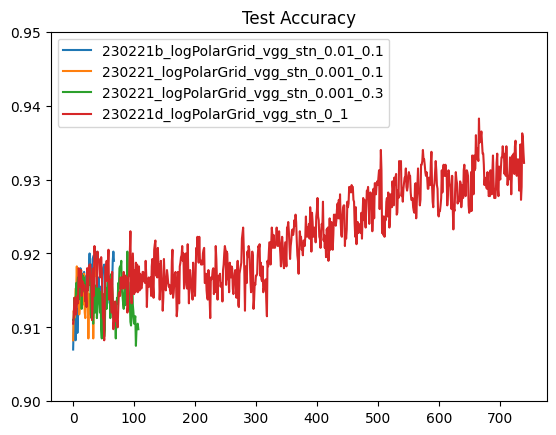

In [ ]:
for f_prefix in ("230221b_logPolarGrid_vgg_stn_0.01_0.1",
                 "230221_logPolarGrid_vgg_stn_0.001_0.1",
                 "230221_logPolarGrid_vgg_stn_0.001_0.3",
                   "230221d_logPolarGrid_vgg_stn_0_1"):
    with open(f"{path}{f_prefix}.pkl", "rb") as f:
        data = pickle.load(f)
    data=edict(data)
    plt.plot(data.test_acc, label=f_prefix)
plt.legend()
plt.title('Test Accuracy')
plt.ylim(0.9, 0.95)

In [22]:
model = torch.load(f"{path}{f_prefix}.pt", map_location=device)

In [23]:
model.eval()

Grid_AttentionTransNet(
  (vgg): VGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=True)

In [24]:
data, target = next(iter(dataloader['train']))

In [25]:
with torch.no_grad():
    cat, theta, z = model(data.to(device))
cat = torch.argmax(F.softmax(cat),1)

tensor([-0.0046,  0.2050])


/home/manu/venv/lib/python3.9/site-packages/torch/nn/functional.py:4289: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(
/home/manu/venv/lib/python3.9/site-packages/torch/nn/functional.py:4227: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(
/tmp/ipykernel_218226/3826532028.py:3: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  cat = torch.argmax(F.softmax(cat),1)


In [26]:
data, data_aff, target, cat, theta, z = [[]]*10, [[]]*10, [[]]*10, [[]]*10, [[]]*10, [[]]*10
center = args.image_size / 2 - 0.5 #np.array([a, args.image_size/2-0.5])
h_width = args.image_size / 2
n_samples = 5

for i in range(n_samples):
    data[i], target[i] = next(iter(dataloader['train']))
    with torch.no_grad():
        c, theta[i], z[i] = model(data[i].to(device))
    cat[i] = torch.argmax(F.softmax(c),1)
    data_aff[i] = [[]] * args.batch_size
    for j in range(len(data[i])):
        data_aff[i][j] = img_denorm(data[i][j], v_mean, v_std)

tensor([ 0.0801, -0.0266])


/tmp/ipykernel_218226/1737778202.py:10: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  cat[i] = torch.argmax(F.softmax(c),1)


tensor([0.0220, 0.0582])
tensor([ 0.1155, -0.1267])
tensor([0.0424, 0.0500])
tensor([0.1093, 0.3924])


In [27]:

'''for i in range(n_samples):

    for num in range(args.batch_size):
        plt.figure(figsize=(5,10))
        plt.subplot(1,2,1)
        img = data_aff[i][num].unsqueeze(0)
        th = theta[i][num:num+1,...]
        #theta[0,:,2] = torch.FloatTensor((0,.5))
        #print(th)
        grid_size = torch.Size([1, 3, 240, 240])
        grid = F.affine_grid(th, grid_size)
        img_grid = F.grid_sample(img, grid)
        plt.imshow(data_aff[i][num].permute(1,2,0).detach().numpy())
        plt.title(str(num)+', '+str(target[i][num]))
        plt.subplot(1,2,2)
        plt.imshow(img_grid[0,:].permute(1,2,0).detach().numpy())
        plt.plot(center, center,'w+')
        plt.title(cat[i][num])'''

"for i in range(n_samples):\n\n    for num in range(args.batch_size):\n        plt.figure(figsize=(5,10))\n        plt.subplot(1,2,1)\n        img = data_aff[i][num].unsqueeze(0)\n        th = theta[i][num:num+1,...]\n        #theta[0,:,2] = torch.FloatTensor((0,.5))\n        #print(th)\n        grid_size = torch.Size([1, 3, 240, 240])\n        grid = F.affine_grid(th, grid_size)\n        img_grid = F.grid_sample(img, grid)\n        plt.imshow(data_aff[i][num].permute(1,2,0).detach().numpy())\n        plt.title(str(num)+', '+str(target[i][num]))\n        plt.subplot(1,2,2)\n        plt.imshow(img_grid[0,:].permute(1,2,0).detach().numpy())\n        plt.plot(center, center,'w+')\n        plt.title(cat[i][num])"

/tmp/ipykernel_218226/2485901631.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


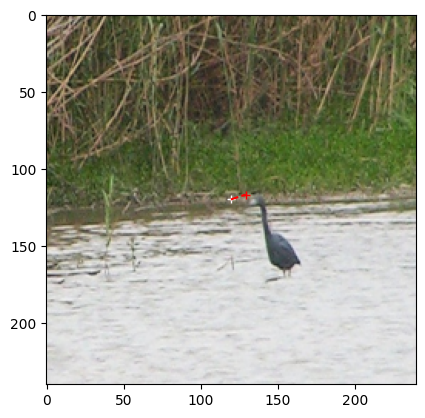

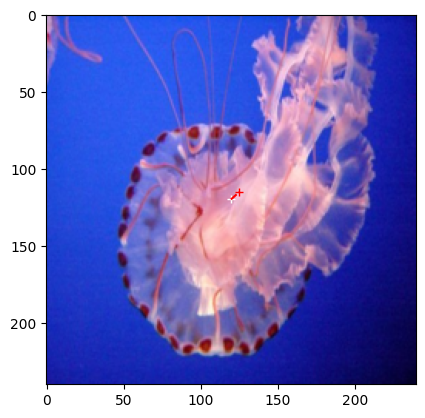

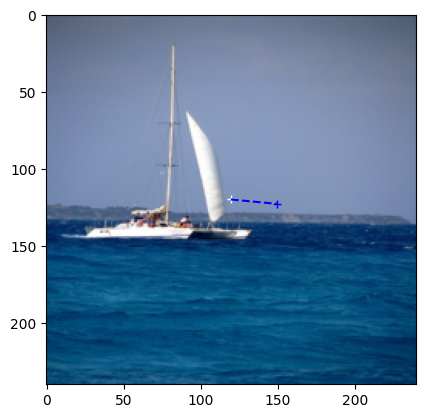

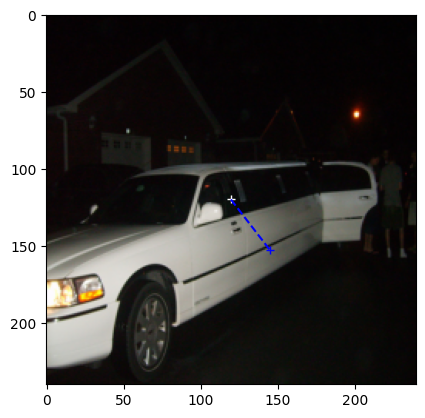

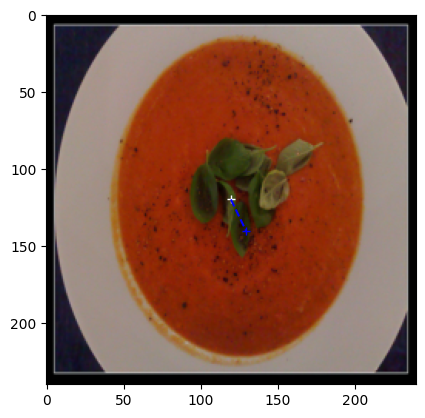

...

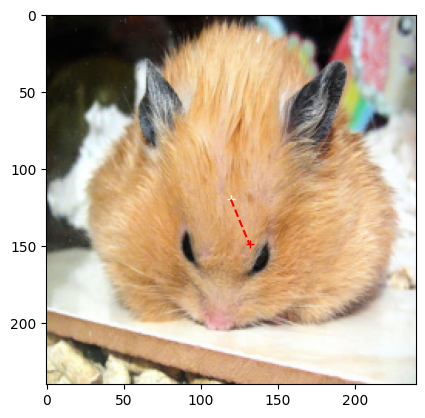

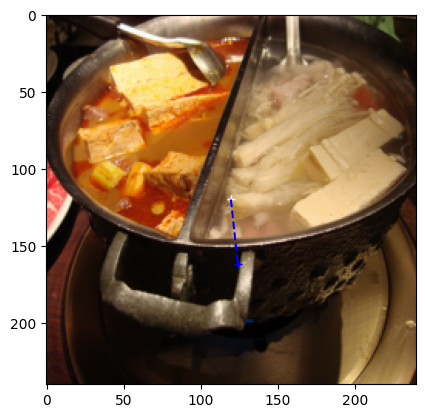

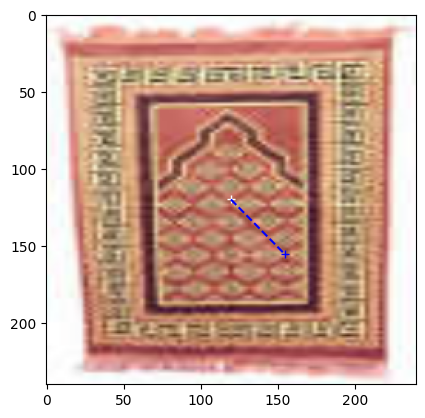

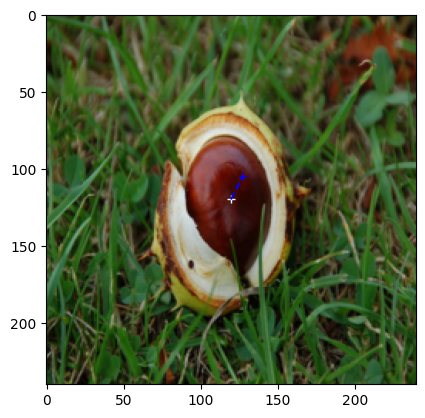

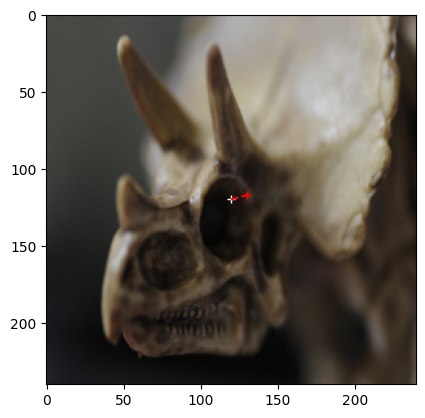

In [28]:
for i in range(n_samples):
    for num in range(args.batch_size):
        plt.figure()
        plt.imshow((data_aff[i][num].permute(1,2,0).detach().numpy()))
        plt.plot(center,center,'w+')
        if cat[i][num] == 1:
            plt.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'r+')
            plt.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'r--')
        else:
            plt.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'b+')
            plt.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'b--')


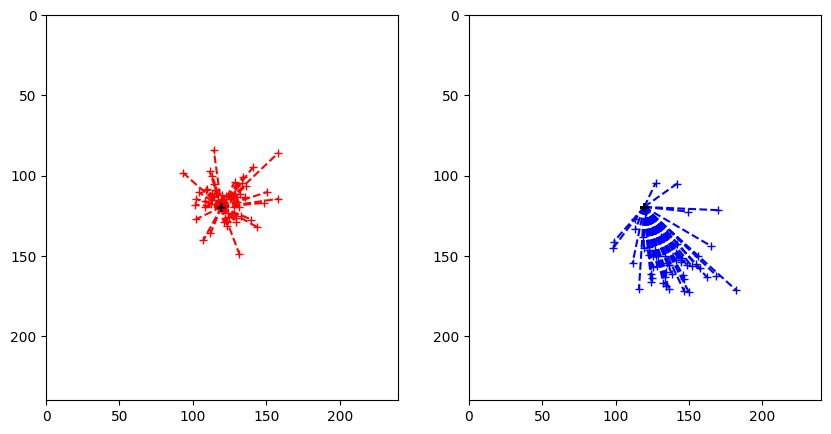

In [29]:
#data, target, cat, theta, z = [[]]*10, [[]]*10, [[]]*10, [[]]*10, [[]]*10
center = args.image_size / 2 - 0.5 #np.array([a, args.image_size/2-0.5])
#h_width = args.image_size / 2
plt.figure(figsize=(10,5))
for i in range(n_samples):
    for num in range(args.batch_size):
        if cat[i][num] == 1:
            ax = plt.subplot(1,2,1)
            ax.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'r+')
            ax.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'r--')
        else:
            ax = plt.subplot(1,2,2)
            ax.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'b+')
            ax.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'b--')        
        plt.plot(center, center,'k+')
        ax.set_xlim(0,args.image_size)
        ax.set_ylim(0,args.image_size)
for ax in (plt.subplot(1,2,1), plt.subplot(1,2,2)):
    ax.invert_yaxis()


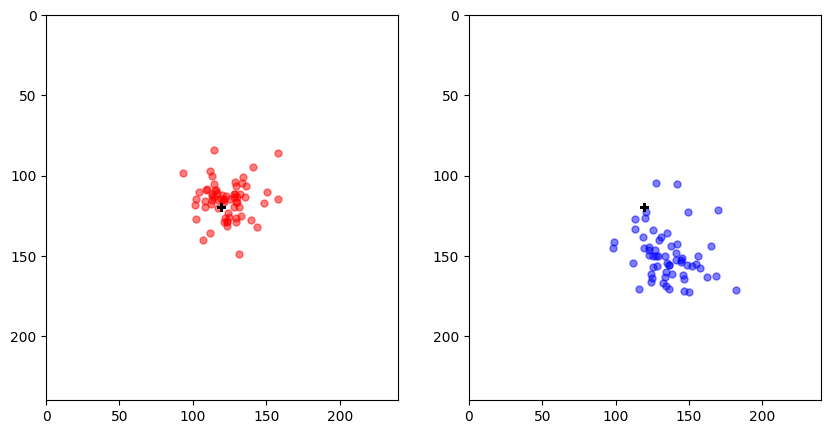

In [30]:
#data, target, cat, theta, z = [[]]*10, [[]]*10, [[]]*10, [[]]*10, [[]]*10
center = args.image_size / 2 - 0.5 #np.array([a, args.image_size/2-0.5])
#h_width = args.image_size / 2
plt.figure(figsize=(10,5))
for i in range(n_samples):
    for num in range(args.batch_size):
        if cat[i][num] == 1:
            ax = plt.subplot(1,2,1)
            ax.plot(center + z[i][num][0].item()*h_width, center + z[i][num][1].item()*h_width,'.r', markersize=10, alpha=.5)
            #ax.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'r--')
        else:
            ax = plt.subplot(1,2,2)
            ax.plot(center + z[i][num][0].item()*h_width, center + z[i][num][1].item()*h_width,'.b', markersize=10, alpha=.5)
            #ax.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'b--')        
        plt.plot(center, center,'k+')
        ax.set_xlim(0,args.image_size)
        ax.set_ylim(0,args.image_size)
for ax in (plt.subplot(1,2,1), plt.subplot(1,2,2)):
    ax.invert_yaxis()


In [31]:
center + z[i][num][0]*h_width, center + z[i][num][1]*h_width

(tensor(130.1134), tensor(116.5678))

In [32]:
mem_z  = {}
mem_cat  = {}

tensor([ 0.1155, -0.1267])


/tmp/ipykernel_218226/4239331951.py:10: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  cat1 = torch.argmax(F.softmax(cat1),1)


tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000

/tmp/ipykernel_218226/4239331951.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5,10))


tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])
tensor([ 0.1155, -0.1267])
tensor([[[ 1.0000,  0.0000,  0.1155],
         [ 0.0000,  1.0000, -0.1267]]])


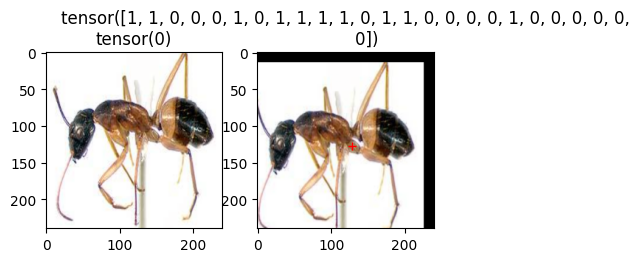

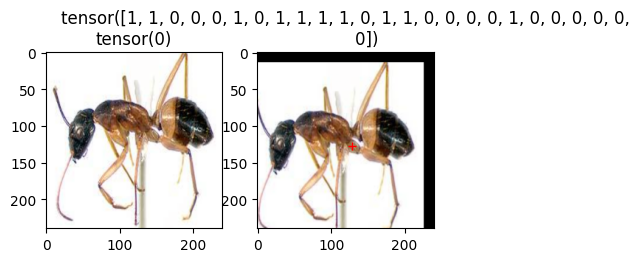

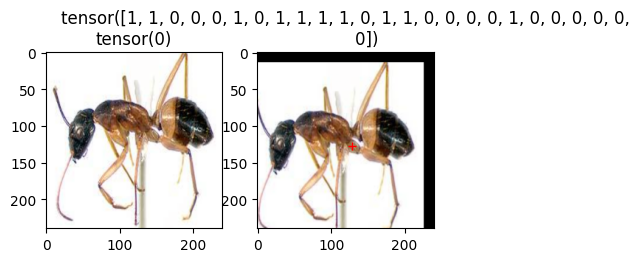

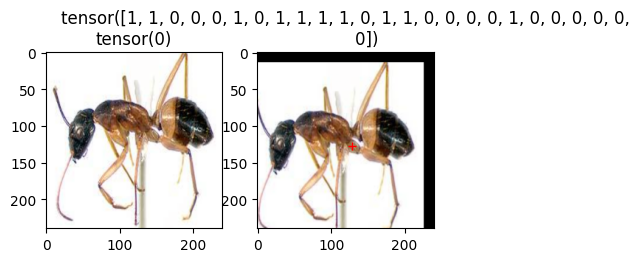

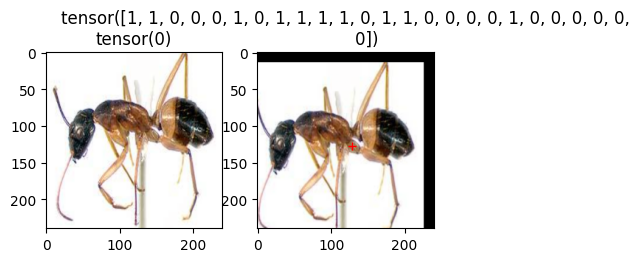

...

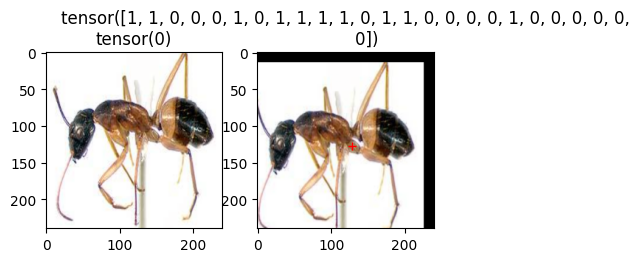

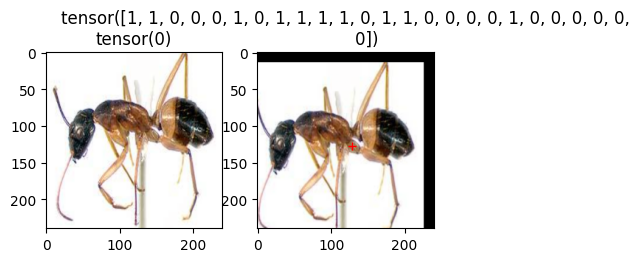

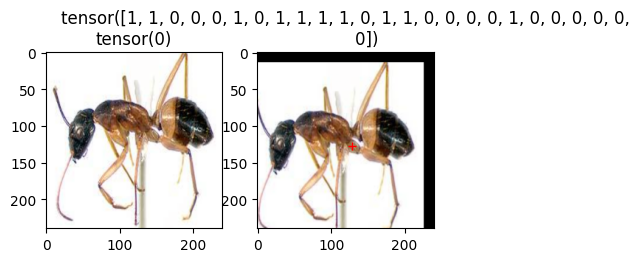

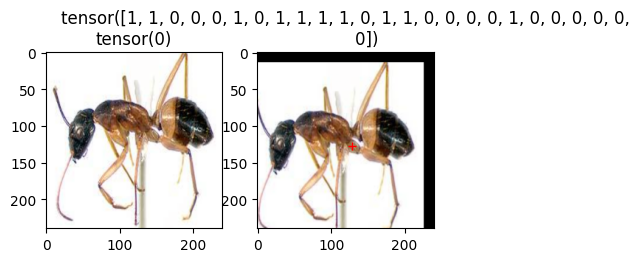

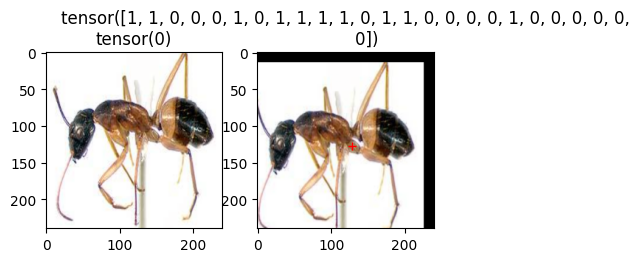

In [33]:
sample_num = 2

mem_z[sample_num]  = []
mem_cat[sample_num]  = []

        #theta = theta.view(-1, 2, 3)
for num in [0,]*25: #range(50):
    with torch.no_grad():
        cat1, theta1, z1 = model(data[sample_num])
    cat1 = torch.argmax(F.softmax(cat1),1)
    plt.figure(figsize=(5,10))
    plt.subplot(1,2,1)
    img = data_aff[sample_num][num].unsqueeze(0)   
    th = theta1[num:num+1,...]
    mem_z[sample_num].append(z1)
    mem_cat[sample_num].append(cat1)
    #theta[0,:,2] = torch.FloatTensor((0,.5))
    print(th)
    grid_size = torch.Size([1, 3, 240, 240])
    grid = F.affine_grid(th, grid_size)
    img_grid = F.grid_sample(img, grid)
    plt.imshow(data_aff[sample_num][num].permute(1,2,0).detach().numpy())
    plt.title(label[num])
    plt.subplot(1,2,2)
    plt.imshow(img_grid[0,:].permute(1,2,0).detach().numpy())
    if cat1[num] == 1:
        plt.plot(128,128,'r+')
    else:
        plt.plot(128,128,'b+')
    plt.title(cat[num])

/tmp/ipykernel_218226/2525084377.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


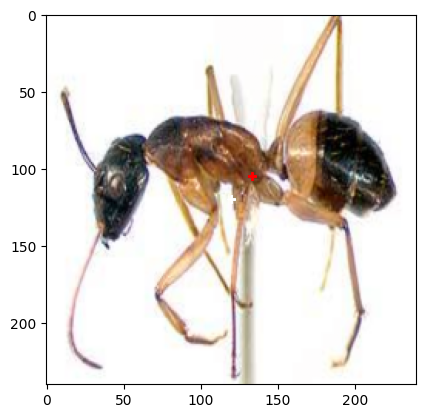

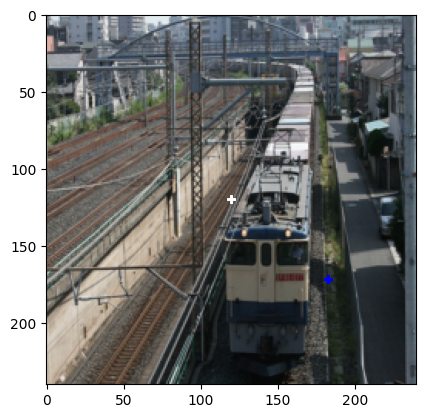

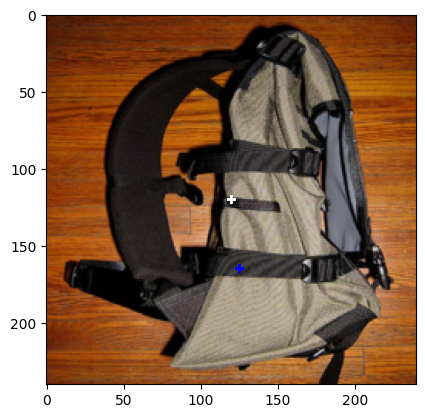

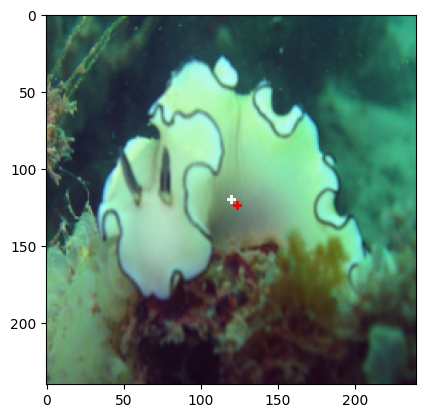

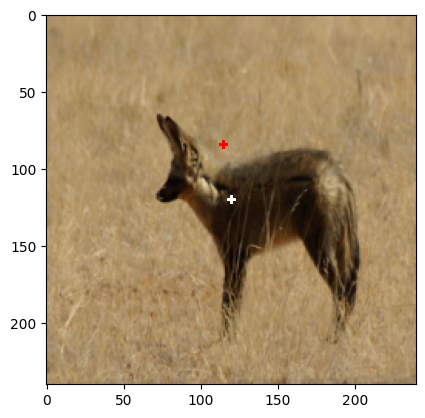

...

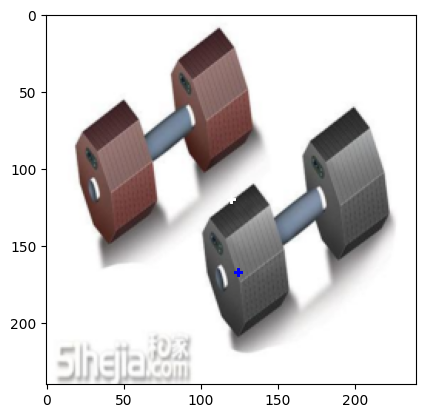

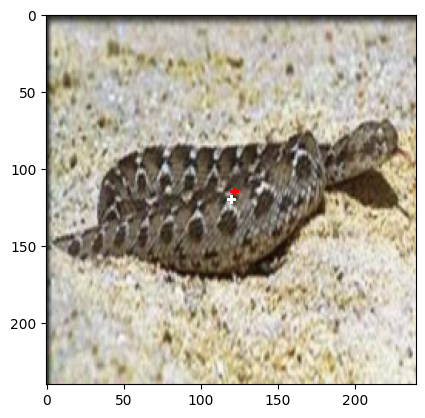

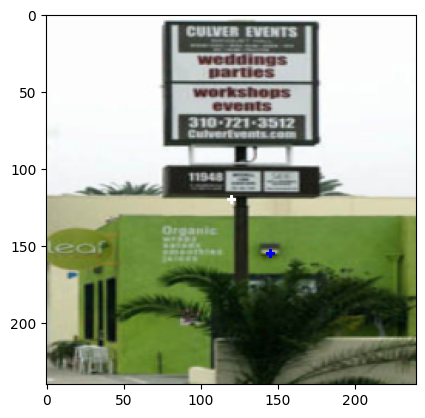

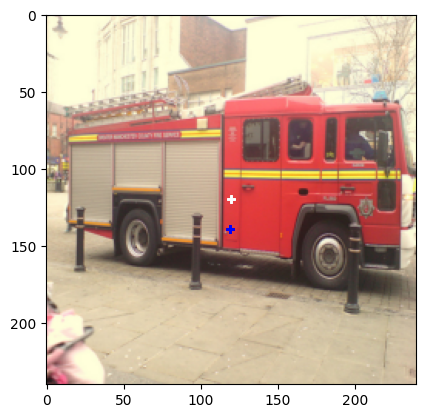

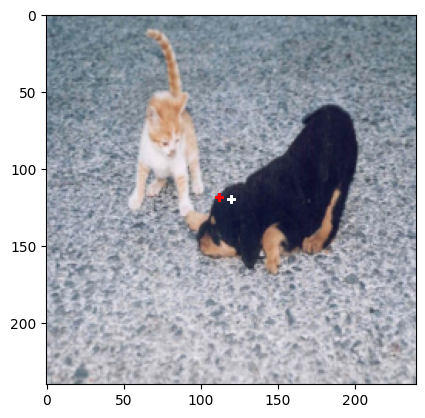

In [34]:
for num in range(args.batch_size):
    plt.figure()
    plt.imshow(data_aff[sample_num][num].permute(1,2,0).detach().numpy())
    for i, z1 in enumerate(mem_z[sample_num]):
        plt.plot(center, center,'w+')
        if mem_cat[sample_num][i][num] == 1:
            plt.plot(center + z1[num][0]*h_width, center + z1[num][1]*h_width,'r+')
        else:
            plt.plot(center + z1[num][0]*h_width, center + z1[num][1]*h_width,'b+')

In [35]:
sample_num

2